# 3.4 基于感知的自主飞行-寻找小鸭子

## 增加目标识别功能

前面一节的课程，无人机已经能够看到环境中的物体，但如有要进一步的操作，如飞过去，扔个砖头，

还需要目标的位置，上一节是系统直接给到的，而这一节，加装了目标识别功能，无人机就可以自行获得目标在视野中的相对位置。

我们给无人机增加的函数为：

detect(object_name)

其输入为需要查找的目标名称object_name，函数内会调用成员函数，获得摄像头采集的图片

其返回3个变量 ：
- obj_list，它是场景中检测到的对象名称的列表。
- obj_locs，每个对象在图像中的边界框坐标列表。
- img_with_box, 带有标注框的图片

另外需要注意，object只能是英文

另外，为了方便无人机自主导航，我们还添加了如下几个基本动作：
- forward()：向前移动1米。
- turn_left()：左转10度。
- turn_right()：右转10度。


In [19]:
def detect(self, object_name):
    """
    在图像 img 上运行对象检测模型，并返回两个变量 - obj_list，它是场景中检测到的对象名称的列表。obj_locs，每个对象在图像中的边界框坐标列表。
    :param object_name:
    :return:obj_id_list,obj_locs,img_with_box #带box的图片
    """
    #step 1，读取摄像头图片，已经是RGB的了
    rgb_image = self.get_image()

    #直接使用cv图片win下有bug
    # 生成随机文件名（含扩展名）
    file_name = f"random_{uuid.uuid4().hex}.png"  # 示例输出：random_1a2b3c4d5e.png
    cv2.imwrite(file_name, rgb_image)
    
    #step2, 目标检测
    gdino = GroundingDINOAPIWrapper(gdino_token) #使用自己的token
    prompts = dict(image=file_name, prompt=object_name)
    result = gdino.inference(prompts)
    
    #step3, 转换成需要的格式
    obj_id_list = result["categorys"]
    #[xmin, ymin, xmax, ymax]
    obj_locs = result["boxes"]
    
    #画框
    image_pil = Image.open(prompts['image'])
    img_with_box = visualize(image_pil, result)
    return obj_id_list, obj_locs,img_with_box

## 构建提示词

In [52]:
#知识库写入aisim_lession34.txt
kg_promot_file = "prompts/aisim_lession34.txt"

kg_prompt = """
想象一下您正在帮助我与 AirSim 模拟器进行交互。

我们正在控制一个实体Agent。在任何给定时间点，您都具有以下能力。您还需要输出某些请求的代码。
问题 - 向我提出一个澄清问题
原因 - 解释你为什么这样做。
代码 - 输出达到预期目标的代码命令。

场景由多个对象组成。我们可以使用以下功能，请尽可能仅使用这些功能：

洞察力：

aw.detect(object_name)：从无人机的前置摄像头渲染图像，在图像上运行对象检测模型，查找object_name，并返回3个变量 
- obj_list，它是场景中检测到的对象名称的列表。
- obj_locs，每个对象在图像中的边界框坐标列表。
- img_with_box, 带有标注框的图片，格式为PngImageFile，可以通过img_with_box.size方式获得其宽高(宽，高)。还可以使用display(img_with_box) 进行展示，但需要先引用：from IPython.display import display

注意这个函数输入的目标名称object_name只能是英文，如果需要搜索的名称是中文，则需要翻译一下

行动：
aw.takeoff() - 起飞无人机。
aw.land() - 无人机着陆。
aw.forward()：向前移动1米。
aw.turn_left()：左转10度。
aw.turn_right()：右转10度。

生成代码时，你无需考虑aw的import问题，在环境中已经声明

您不得使用任何其他假设函数。您可以使用 Python 库中的函数，例如 math、numpy 等。准备好了吗？



"""

pt_file = open(kg_promot_file, "w", encoding="utf-8")
pt_file.write(kg_prompt)
pt_file.close()

## 交互式执行

In [53]:
#先生成1个独立的airsim agent，用于人工执行代码
import airsim_wrapper
aw = airsim_wrapper.AirSimWrapper()

Connected!
Client Ver:1 (Min Req: 1), Server Ver:1 (Min Req: 1)



In [54]:
#生成agent
import airsim_agent
my_agent = airsim_agent.AirSimAgent(knowledge_prompt=kg_promot_file)

In [55]:
command = "起飞"
ret = my_agent.process(command, False) #不执行代码
print("ret:", ret)

ret: 问题 - 无
原因 - 需求明确，就是让无人机起飞，不需要进一步澄清。
代码 - 
```python
aw.takeoff()
```


In [56]:
#人工执行-----------------------------------------------------

aw.takeoff()

In [57]:
command = """
我需要你帮我找到一个目标。目标可能散布在场景中，因此，如果您没有立即找到它，一个好的策略是转身几次，看看它是否变得可见。给我代码来探索并找到小黄鸭。
"""
ret = my_agent.process(command, False) #不执行代码
print("ret:", ret)

ret: 问题 - 请问在尝试转身寻找小黄鸭时，最多允许无人机转身多少次呢？因为如果没有次数限制，无人机可能会一直旋转下去。
原因 - 为了让代码具有合理性和可终止性，需要明确转身的最大次数，避免出现无限循环的情况。
代码 - 以下是在未明确最大转身次数时的初步代码框架，后续可根据明确的次数进行修改。
```python
import math

# 起飞
aw.takeoff()

# 翻译中文目标名称为英文
target_name = "rubber duck"
found = False

while not found:
    obj_list, obj_locs, img_with_box = aw.detect(target_name)
    if target_name in obj_list:
        found = True
        print("找到了小黄鸭！")
    else:
        # 这里假设先左转，后续可根据实际情况调整
        aw.turn_left()


```


找到了 rubber duck！


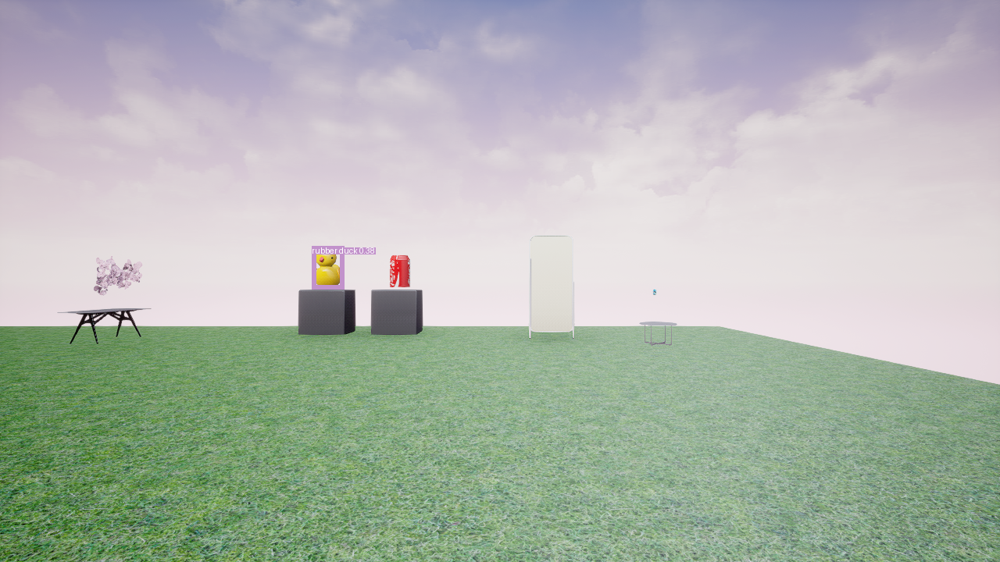

In [58]:
import time
from IPython.display import display

# 翻译中文名称为英文,检测小黄鸭（英文为 "rubber duck"）
target_name = "rubber duck"
max_turns = 36  # 假设最多转身36次，可根据后续澄清修改
turn_count = 0

while True:
    obj_list, obj_locs,img_with_box  = aw.detect(target_name)
    if target_name in obj_list:
        print(f"找到了 {target_name}！")
        display(img_with_box)
        break
    elif turn_count < max_turns:
        aw.turn_right()
        turn_count += 1
    else:
        print(f"经过 {max_turns} 次转身仍未找到 {target_name}。")
        break

In [59]:
command = """
太棒了！现在假设我们确实找到了小黄鸭。现在我想向它迈进。我们拥有的唯一信息是图像中小黄鸭边界框的位置。你能给我代码来实现这一点吗？
"""
ret = my_agent.process(command, False) #不执行代码
print("ret:", ret)

ret: 问题 - 由于仅知道小黄鸭边界框在图像中的位置，而不知道图像位置与实际物理位置的映射关系，请问是否可以假设图像中心对应无人机正前方，并且可以根据边界框中心相对于图像中心的偏移角度来控制无人机转向，以及是否可以假设无人机每次前进固定距离就能靠近目标？
原因 - 要根据图像中边界框位置控制无人机向目标迈进，需要明确图像位置和实际物理位置的关联规则，这样才能合理地编写代码控制无人机的转向和前进动作。
代码 - 以下是基于上述假设的代码实现：
```python
import math

# 假设已经找到了小黄鸭，获取边界框信息
obj_list, obj_locs, img_with_box = aw.detect("rubber duck")
if "rubber duck" in obj_list:
    # 找到小黄鸭在列表中的索引
    index = obj_list.index("rubber duck")
    # 获取小黄鸭边界框坐标
    box = obj_locs[index]
    # 计算边界框中心
    box_center_x = (box[0] + box[2]) / 2
    box_center_y = (box[1] + box[3]) / 2

    # 获取图像宽高
    img_width, img_height = img_with_box.size
    # 计算图像中心
    img_center_x = img_width / 2
    img_center_y = img_height / 2

    # 计算边界框中心相对于图像中心的水平偏移量
    offset_x = box_center_x - img_center_x

    # 根据偏移量计算需要转动的角度
    # 假设图像宽度对应 90 度视角范围
    turn_angle = (offset_x / img_width) * 90
    # 计算需要左转或右转的次数
    turn_count = int(turn_angle / 10)

    if turn_count > 0:
        for _ in range(turn_count):
            aw.turn_ri

['rubber duck']
img_center_x 640.0 duck_center_x 420.27549743652344
[]
img_center_x 640.0 duck_center_x 420.27549743652344
['rubber duck']


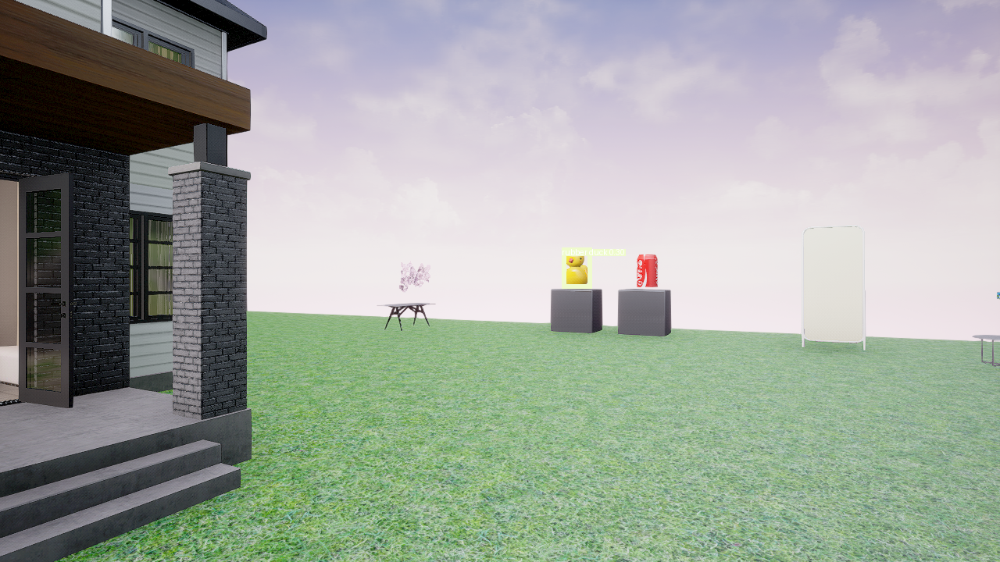

方向正确，向前进
['rubber duck']


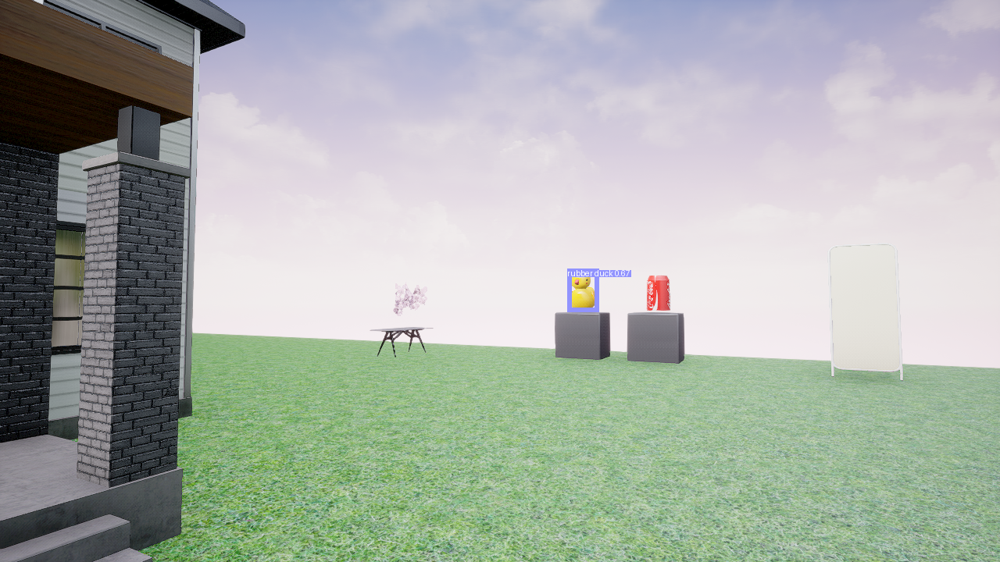

img_center_x 640.0 duck_center_x 746.3839111328125
['rubber duck']


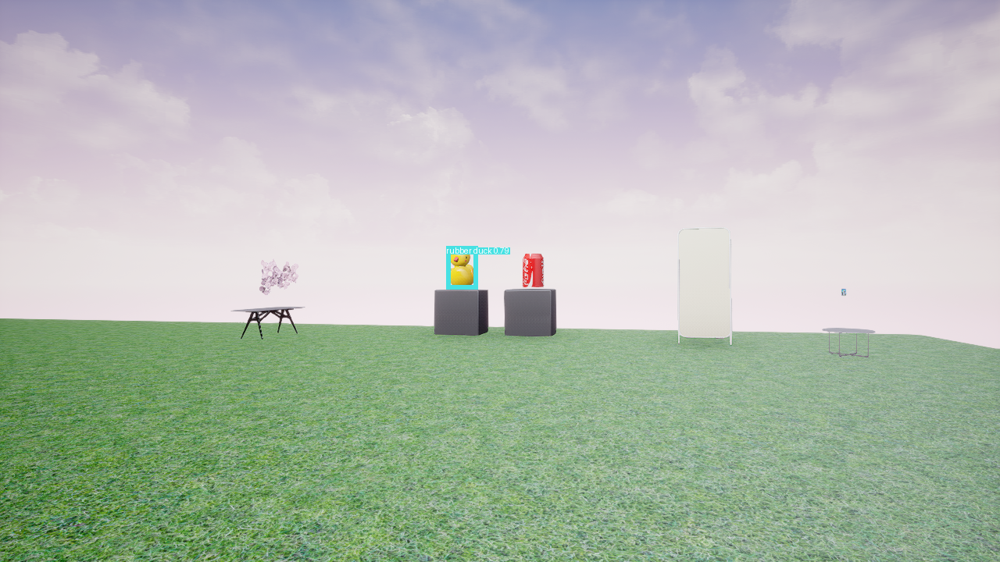

方向正确，向前进
[]
方向正确，向前进
['rubber duck']


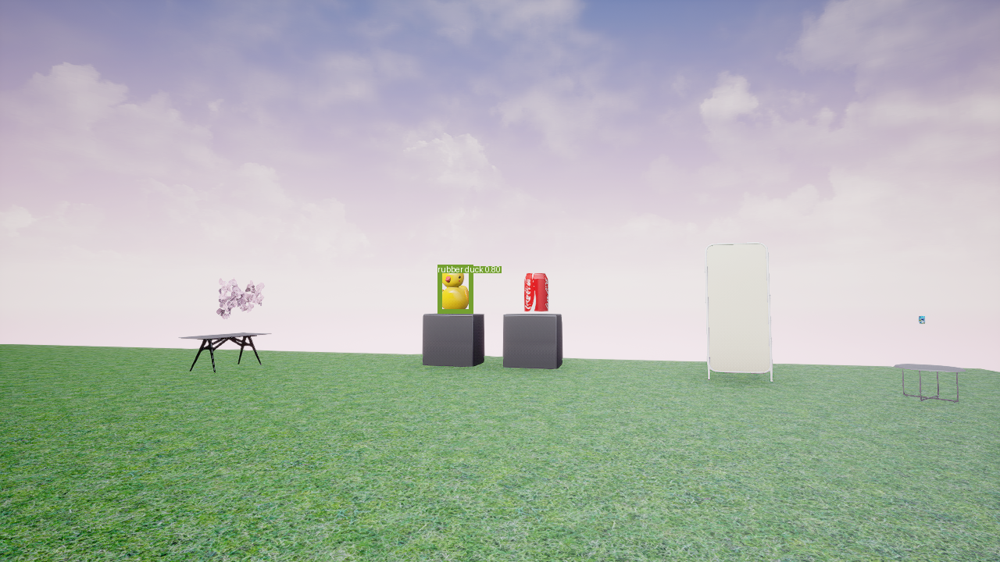

方向正确，向前进
['rubber duck']


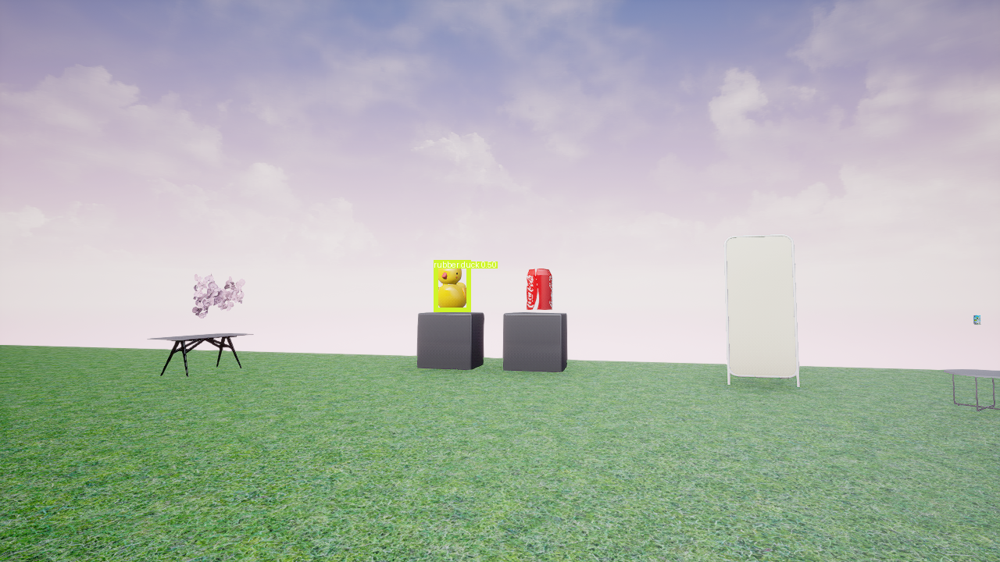

方向正确，向前进
['rubber duck']


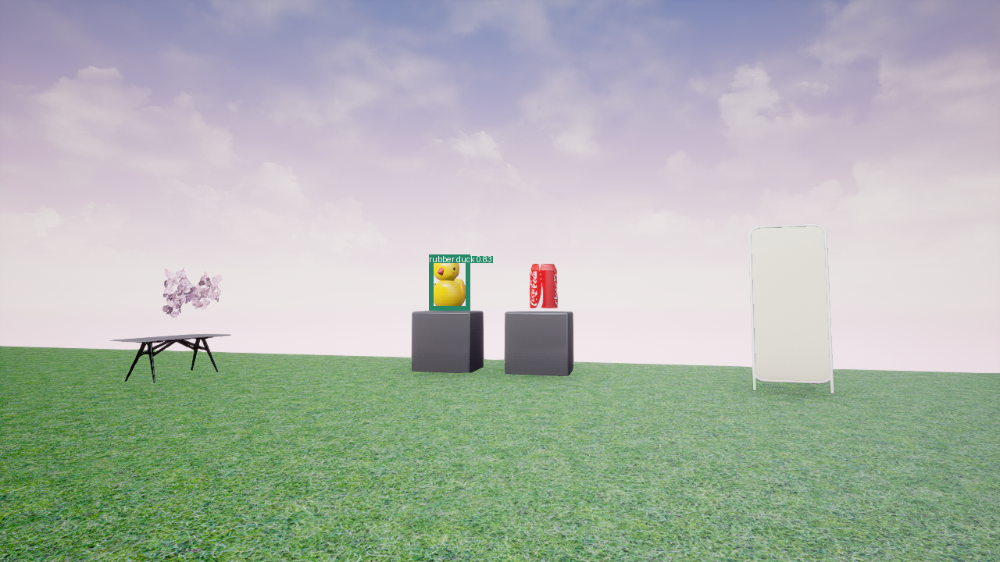

方向正确，向前进
['rubber duck']


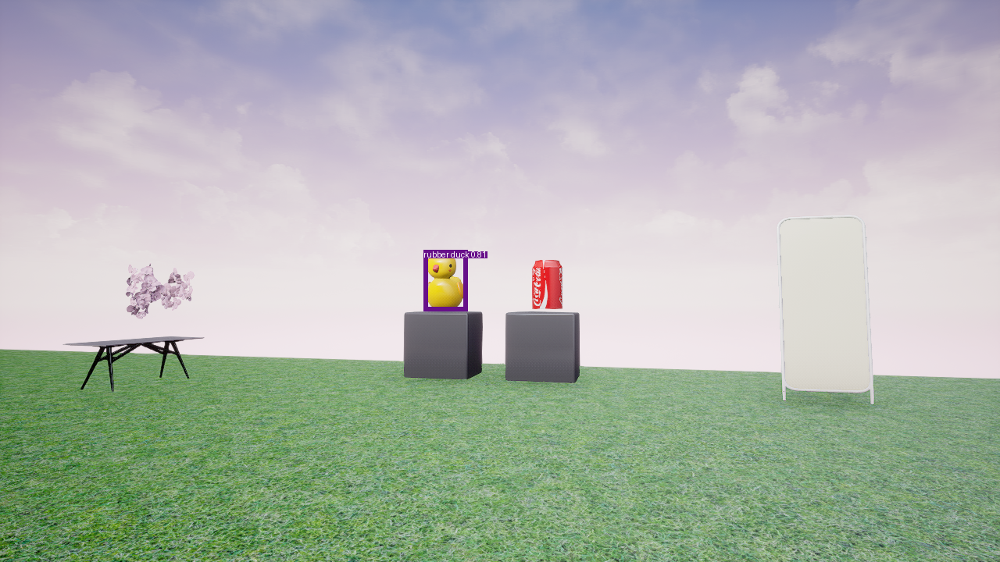

方向正确，向前进
['rubber duck']


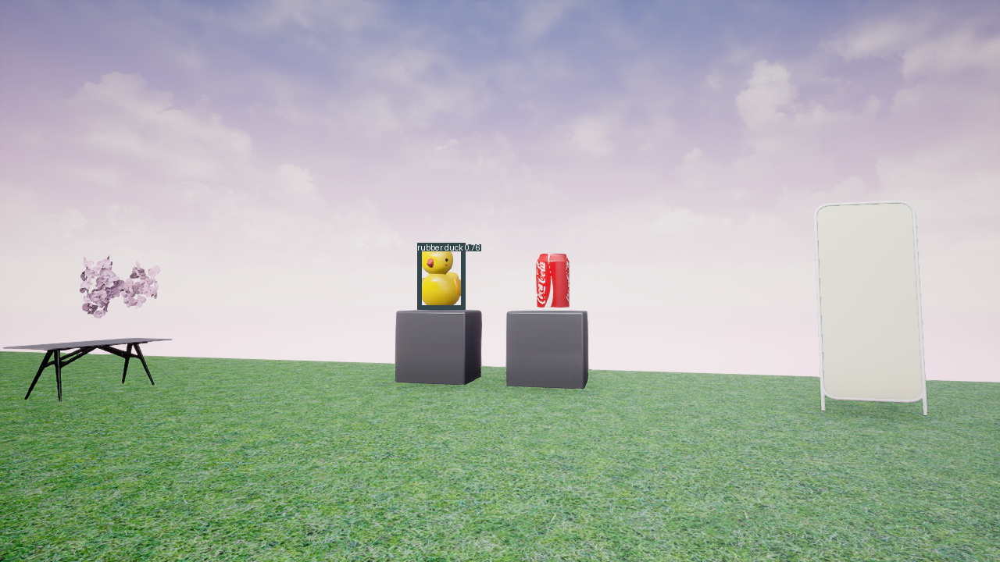

方向正确，向前进
['rubber duck']


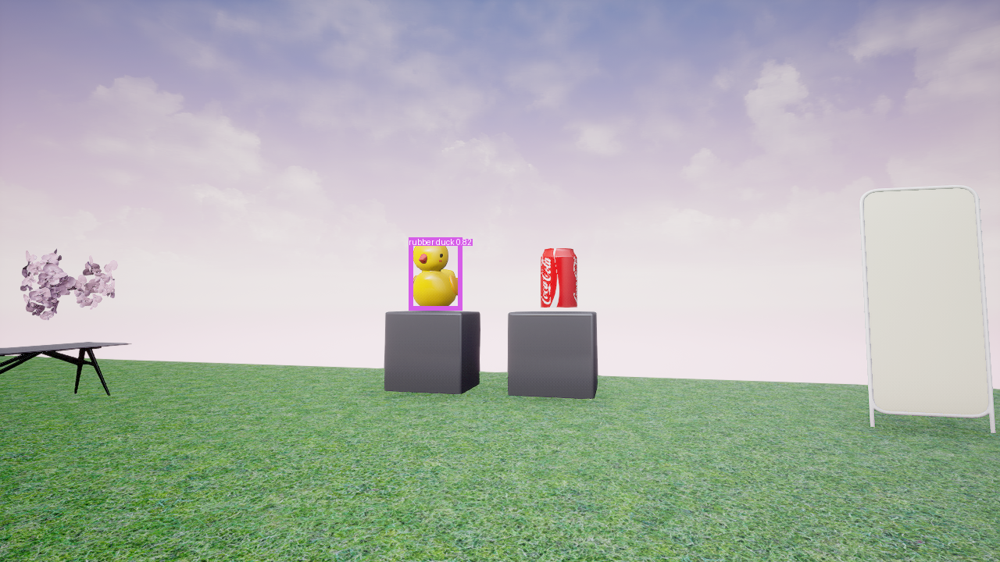

方向正确，向前进
['rubber duck']


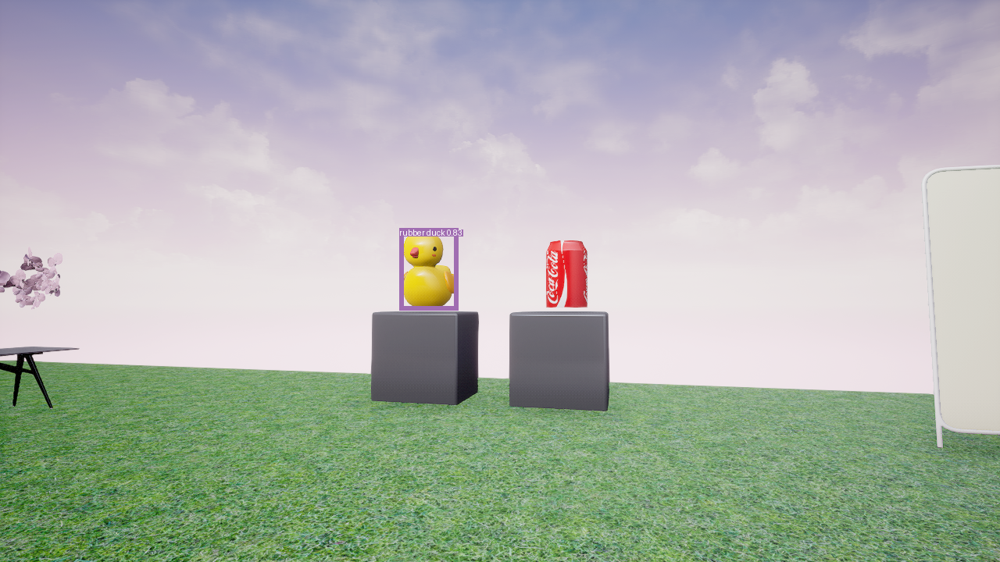

方向正确，向前进
['rubber duck']


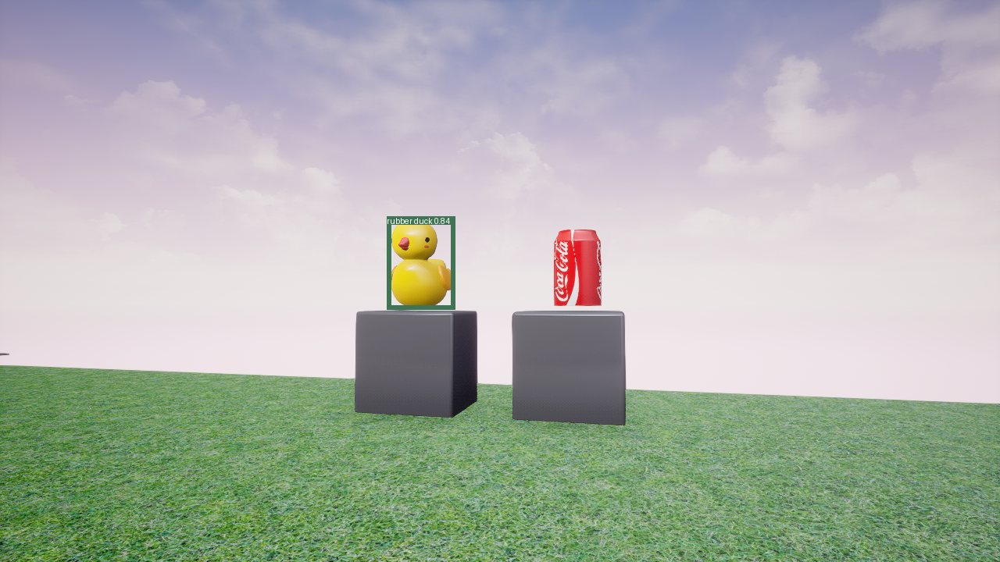

In [60]:
import numpy as np

# 假设之前已经检测到小黄鸭，这里使用之前检测得到的变量
obj_list, obj_locs, img_with_box = aw.detect('rubber duck')
print(obj_list)

# 找到小黄鸭边界框的索引
duck_index = obj_list.index('rubber duck')
duck_bbox = obj_locs[duck_index]

# 计算图像的中心
img_width,img_height = img_with_box.size
img_center_x = img_width / 2

# 计算小黄鸭边界框的中心
duck_center_x = (duck_bbox[0] + duck_bbox[2]) / 2

# 设定一个误差范围，当小黄鸭中心与图像中心的偏差在这个范围内时，认为无人机正对着小黄鸭
error_threshold = 100

for i in range(10):#最多10米

    #确定方向
    while abs(duck_center_x - img_center_x) > error_threshold:
        print("img_center_x",img_center_x,"duck_center_x",duck_center_x)
        if duck_center_x < img_center_x:
            # 小黄鸭在图像左侧，左转
            aw.turn_left()
        else:
            # 小黄鸭在图像右侧，右转
            aw.turn_right()
        
        # 再次检测小黄鸭以更新边界框位置
        obj_list, obj_locs, img_with_box = aw.detect('rubber duck')
        print(obj_list)

        if "rubber duck" in obj_list:
            display(img_with_box)
            duck_index = obj_list.index('rubber duck')
            duck_bbox = obj_locs[duck_index]
            duck_center_x = (duck_bbox[0] + duck_bbox[2]) / 2

    # 当无人机正对着小黄鸭时，向前移动
    print("方向正确，向前进")
    aw.forward()
    # 再次检测小黄鸭以更新边界框位置
    obj_list, obj_locs, img_with_box = aw.detect('rubber duck')
    print(obj_list)
    if "rubber duck" in obj_list:
        display(img_with_box)
        duck_index = obj_list.index('rubber duck')
        duck_bbox = obj_locs[duck_index]
        duck_center_x = (duck_bbox[0] + duck_bbox[2]) / 2

In [51]:
aw.set_yaw(0)

可以看到，基于单个摄像头的目标识别功能，大模型可以基于最简单的运动控制（pid的一种简化），来飞向目标小鸭子

大致原理如下：

<img src='img/duck.jpg' width='640px' />

也就是说，无人机摄像头采集的图片，左上角为原点，也就是(0,0)坐标，

如果小鸭子位于图片中心的左侧，则无人机向左转，如果位于图片中心的右侧，则向右转。

然后向前移动一段距离，再进行视觉判断。

大模型生成的代码基本框架是没问题的，但要完美的执行，一般还需要多次提示。

## 思考问题
这一章，我们给了无人机视觉认知和目标识别能力

如果我们再给无人机一个拿东西的能力take(),以及放东西的能力drop()

然后我给无人机说 "我渴了"

无人机该如何响应呢？